<a href="https://colab.research.google.com/github/youngyoung0511/Sound-AI/blob/Data-processing/1128_drum_onset_beat_Extraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# setting

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%%capture
!pip install PyWavelets librosa matplotlib numpy
import librosa
import numpy as np
import matplotlib.pyplot as plt
import pywt


In [ ]:
import numpy as np
import librosa
import matplotlib.pyplot as plt
from scipy.signal import find_peaks



'/content/drive/My Drive/soundAI/BoysLikeGirls.mp3'

MagicCarpetRide_drum.mp3

Every Day.mp3

music.mp3 //꿈나라별나라


In [ ]:
audio_path = '/content/drive/My Drive/soundAI/music.mp3'  # 여기에 mp3 파일 경로를 입력하세요
y, sr = librosa.load(audio_path, sr=None)


# Drum Extraction

1번 논문: NMF와 ICA 알고리즘

In [ ]:
%%capture
!pip install librosa scikit-learn matplotlib numpy


<ipython-input-6-493e4d3d2e9b>:12: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


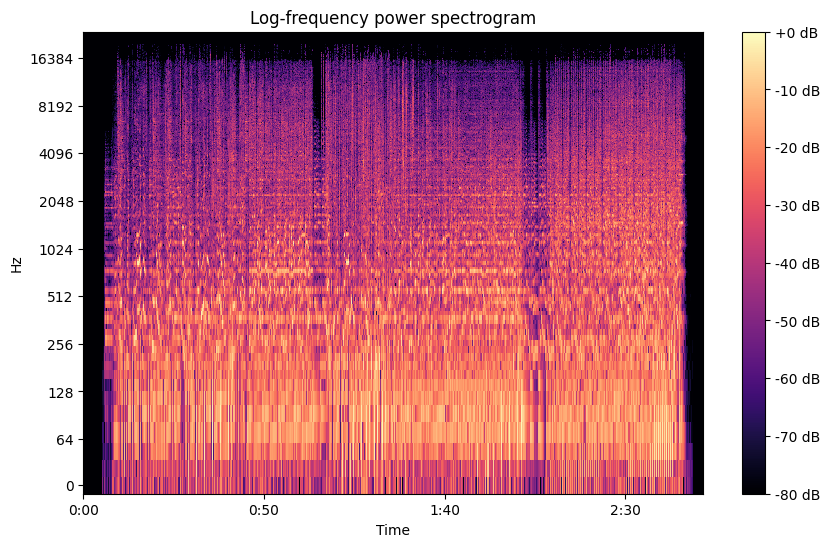

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

# 오디오 파일 로드 (파일 경로는 자신의 파일로 설정해야 함)
audio_file = '/content/drive/My Drive/soundAI/music.mp3'

# 오디오 파일을 로드
y, sr = librosa.load(audio_file, sr=None)  # y는 오디오 신호, sr은 샘플링 주파수

# 스펙트로그램 계산 (크로스 스펙트럴 이미지 생성)
D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)

# 스펙트로그램 시각화
plt.figure(figsize=(10, 6))
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Log-frequency power spectrogram')
plt.show()


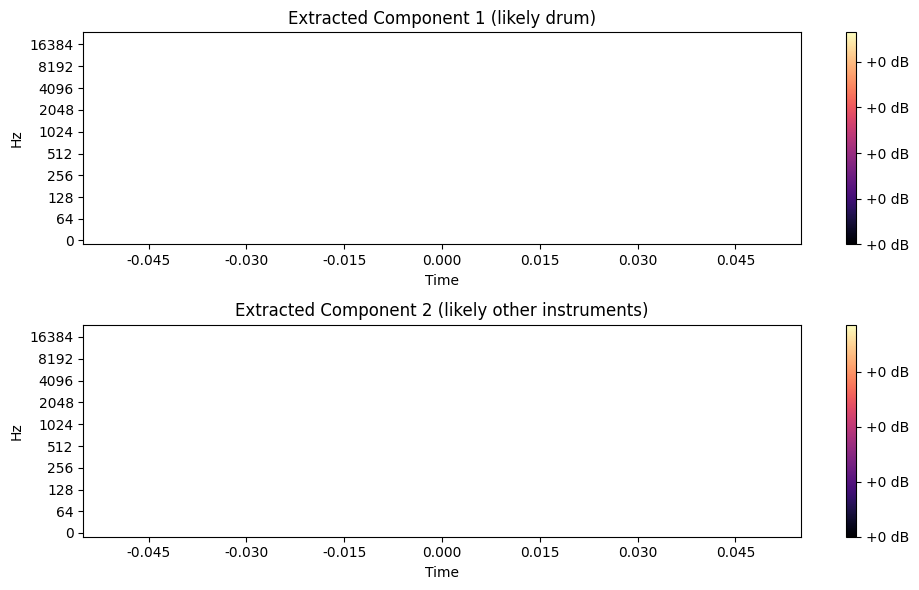

파일이 저장되었습니다: /content/drive/My Drive/soundAI/reconstructed_drum.wav


In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
from sklearn.decomposition import NMF
import numpy as np
import soundfile as sf


# 스펙트로그램 계산 (STFT)
D = librosa.stft(y)

# 로그 스케일로 변환 (음의 값을 처리)
D_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

# 음의 값을 0으로 설정 (NMF에 전달할 때 음의 값이 없어야 함)
D_db[D_db < 0] = 0

# NMF 모델을 사용하여 오디오 신호 분해
n_components = 2  # 예시: 2개의 성분 (드럼과 나머지 악기)
model = NMF(n_components=n_components, init='random', random_state=0)

# 스펙트로그램을 NMF에 맞게 분해 (W만 반환)
W = model.fit_transform(D_db)  # W는 성분, H는 model.components_로 얻음

# H는 model.components_로 추출
H = model.components_

# NMF 결과 시각화
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
librosa.display.specshow(W[:, 0].reshape(-1, 1), sr=sr, x_axis='time', y_axis='log')
plt.title('Extracted Component 1 (likely drum)')
plt.colorbar(format='%+2.0f dB')

plt.subplot(2, 1, 2)
librosa.display.specshow(W[:, 1].reshape(-1, 1), sr=sr, x_axis='time', y_axis='log')
plt.title('Extracted Component 2 (likely other instruments)')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

# 추출된 드럼 트랙 생성
# W 전체를 사용하여 역변환
reconstructed_drum = model.inverse_transform(W)  # W 전체 사용

# 오디오 신호로 변환 (NMF 결과는 스펙트로그램 형태이므로 역변환 필요)
reconstructed_drum_audio = librosa.istft(reconstructed_drum)

# 결과를 Google Drive에 저장
output_path = '/content/drive/My Drive/soundAI/reconstructed_drum.wav'
sf.write(output_path, reconstructed_drum_audio, sr)

print(f"파일이 저장되었습니다: {output_path}")


# spleeter

2.spleeter

1. 5 stem으로 분리해보자

In [ ]:
# Spleeter 설치
!pip install spleeter


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.6/45.6 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.4/49.4 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.3/77.3 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 56.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.8/511.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.8/82.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 44.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 39.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 54.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 438.7/438.7 kB 24.

'/content/drive/My Drive/soundAI/BoysLikeGirls.mp3'

MagicCarpetRide_drum.mp3

Every Day.mp3

music.mp3 //꿈나라별나라

한번 추출하고 이거 돌려서 비활 시켜야 다시 할 수 있음

In [ ]:

import tensorflow as tf
# Eager execution 활성화
tf.compat.v1.disable_eager_execution()  # TensorFlow 2.x에서 eager execution 비활성화

In [ ]:
from google.colab import drive
from spleeter.separator import Separator

# Spleeter 모델 사용 (5-스템 모델)
separator = Separator('spleeter:5stems')  # 5-스템 모델 사용

# Google Drive에 있는 파일 경로 지정
file_path = '/content/drive/My Drive/soundAI/BoysLikeGirls.mp3'  # Google Drive 파일 경로

# Spleeter로 오디오 분리
separator.separate_to_file(file_path, '/content/drive/My Drive/soundAI/BoysLikeGirls_separated/')


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/vocals.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/vocals.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/piano.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/piano.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/drums.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/drums.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/bass.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/bass.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/other.wav written succesfully


INFO:spleeter:File /content/drive/My Drive/soundAI/BoysLikeGirls_separated/BoysLikeGirls/other.wav written succesfully


# open-unmix

In [ ]:

# Open-Unmix 설치
!pip install openunmix



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.0/40.0 kB 1.7 MB/s eta 0:00:00


In [ ]:

import torch
import torchaudio
from openunmix import predict, utils

# 파일 경로 설정
input_file = '/content/drive/My Drive/soundAI/music.mp3'
output_dir = '/content/drive/My Drive/soundAI/music_separated/'

# 오디오 파일 로드
waveform, rate = torchaudio.load(input_file)

# 오디오 분리 수행
estimates = predict.separate(
    audio=waveform,
    rate=rate,
    targets=['vocals', 'drums', 'bass', 'other'],  # 분리 대상
    niter=1,  # 후처리 반복 횟수
    residual=False,  # 잔여 신호 포함 여부
    device='cuda' if torch.cuda.is_available() else 'cpu',  # 장치 설정
    filterbank='torch'  # 필터뱅크 구현 방식
)

# 출력 디렉토리 생성
import os
os.makedirs(output_dir, exist_ok=True)

# 분리된 오디오 저장
for target, estimate in estimates.items():
    output_path = os.path.join(output_dir, f'{target}.wav')
    utils.save_audio(estimate, output_path, rate)
    print(f"분리된 '{target}' 트랙이 '{output_path}'에 저장되었습니다.")

print("모든 파일이 성공적으로 분리 및 저장되었습니다.")

Downloading: "https://zenodo.org/records/5069601/files/vocals-bccbd9aa.pth" to /root/.cache/torch/hub/checkpoints/vocals-bccbd9aa.pth
100%|██████████| 108M/108M [00:05<00:00, 21.6MB/s]
Downloading: "https://zenodo.org/records/5069601/files/drums-69e0ebd4.pth" to /root/.cache/torch/hub/checkpoints/drums-69e0ebd4.pth
100%|██████████| 108M/108M [00:04<00:00, 22.8MB/s]
Downloading: "https://zenodo.org/records/5069601/files/bass-2ca1ce51.pth" to /root/.cache/torch/hub/checkpoints/bass-2ca1ce51.pth
100%|██████████| 108M/108M [00:05<00:00, 21.2MB/s]
Downloading: "https://zenodo.org/records/5069601/files/other-c8c5b3e6.pth" to /root/.cache/torch/hub/checkpoints/other-c8c5b3e6.pth
100%|██████████| 108M/108M [00:05<00:00, 21.7MB/s]
/usr/local/lib/python3.10/dist-packages/openunmix/utils.py:297: UserWarning: resample to model sample rate
  warnings.warn("resample to model sample rate")
/usr/local/lib/python3.10/dist-packages/openunmix/utils.py:300: UserWarning: "sinc_interpolation" resampling met

# demucs

In [ ]:
!pip install demucs

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 12.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.1/87.1 kB 6.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 3.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 8.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.8/239.8 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.9/74.9 kB 4.2 MB/s eta 0:00:00
  Created wheel for demucs: filename=demucs-4.0.1-py3-none-any.whl size=78388 sha256=15a5aa8a64137f13de228baad016a81a95339b149f55ee847f49fd823e

In [ ]:
import os
from demucs.pretrained import get_model
from demucs.apply import apply_model
import torchaudio

# 입력 및 출력 파일 경로 설정
input_file = '/content/drive/My Drive/soundAI/music.mp3'
output_dir = '/content/drive/My Drive/soundAI/music_separated/'

# 모델 로드
model = get_model('htdemucs')  # 'htdemucs', 'demucs' 등 다양한 모델 선택 가능
model.cpu()  # GPU를 사용하려면 .cuda()로 변경

# 출력 디렉토리 생성
os.makedirs(output_dir, exist_ok=True)

# 오디오 파일 로드
waveform, sample_rate = torchaudio.load(input_file)

# 모델 적용 (오디오 분리)
sources = apply_model(model, waveform[None, :, :], split=True, device='cpu')  # 'cpu' 대신 'cuda' 사용 가능

# 드럼 요소 저장 (모델별로 드럼 인덱스는 1번일 가능성이 높음)
drum_audio = sources[0, 1, :, :]  # 모델의 출력 순서에 따라 인덱스를 변경
drum_output_path = os.path.join(output_dir, "drums.wav")

# 텐서를 [채널, 샘플] 형태로 변환
drum_audio_2d = drum_audio.squeeze(0)  # 불필요한 배치 차원 제거 (3D -> 2D)

# 오디오 저장
torchaudio.save(drum_output_path, drum_audio_2d, sample_rate)

print(f"드럼 트랙이 성공적으로 추출되었습니다: {drum_output_path}")


드럼 트랙이 성공적으로 추출되었습니다: /content/drive/My Drive/soundAI/music_separated/drums.wav


'/content/drive/My Drive/soundAI/BoysLikeGirls.mp3'

MagicCarpetRide_drum.mp3

Every Day.mp3

music.mp3 //꿈나라별나라

Love From The Other Side.mp3

In [ ]:
import os
from demucs.pretrained import get_model
from demucs.apply import apply_model
import torchaudio

# 입력 및 출력 파일 경로 설정
input_file = '/content/drive/My Drive/soundAI/Love From The Other Side.mp3'
output_dir = '/content/drive/My Drive/soundAI/music_separated_1130/'

# 모델 로드
model = get_model('htdemucs')  # 'htdemucs', 'demucs' 등 다양한 모델 선택 가능
model.cpu()  # GPU를 사용하려면 .cuda()로 변경

# 출력 디렉토리 생성
os.makedirs(output_dir, exist_ok=True)

# 오디오 파일 로드
waveform, sample_rate = torchaudio.load(input_file)

# 모델 적용 (오디오 분리)
sources = apply_model(model, waveform[None, :, :], split=True, device='cpu')  # 'cpu' 대신 'cuda' 사용 가능

# 드럼 요소만 저장
drum_audio = sources[0, 0, :, :]  # 드럼은 보통 1번 인덱스에 위치
drum_output_path = os.path.join(output_dir, "drums.wav")

# 텐서를 [채널, 샘플] 형태로 변환
drum_audio_2d = drum_audio.squeeze(0)  # 불필요한 배치 차원 제거 (3D -> 2D)

# 드럼 소스 저장
torchaudio.save(drum_output_path, drum_audio_2d, sample_rate)

print(f"드럼 트랙이 성공적으로 추출되었습니다: {drum_output_path}")


드럼 트랙이 성공적으로 추출되었습니다: /content/drive/My Drive/soundAI/music_separated_1130/drums.wav


#Band split RNN - 시도 중단.

In [ ]:
!git clone https://github.com/crlandsc/Music-Demixing-with-Band-Split-RNN.git


Cloning into 'Music-Demixing-with-Band-Split-RNN'...
remote: Enumerating objects: 835, done.
remote: Counting objects: 100% (36/36), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 835 (delta 21), reused 25 (delta 11), pack-reused 799 (from 1)
Receiving objects: 100% (835/835), 122.92 MiB | 21.33 MiB/s, done.
Resolving deltas: 100% (477/477), done.


In [ ]:
!pip install ffmpeg


  Preparing metadata (setup.py) ... done
  Created wheel for ffmpeg: filename=ffmpeg-1.4-py3-none-any.whl size=6082 sha256=e5d278138b6a9037fb5d83c556dd22099cad992a461218ac0730b5cfb8021c51
  Stored in directory: /root/.cache/pip/wheels/8e/7a/69/cd6aeb83b126a7f04cbe7c9d929028dc52a6e7d525ff56003a
Successfully built ffmpeg


In [ ]:
!git clone https://github.com/crlandsc/Music-Demixing-with-Band-Split-RNN.git


Cloning into 'Music-Demixing-with-Band-Split-RNN'...
remote: Enumerating objects: 835, done.
remote: Counting objects: 100% (36/36), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 835 (delta 21), reused 25 (delta 11), pack-reused 799 (from 1)
Receiving objects: 100% (835/835), 122.92 MiB | 23.63 MiB/s, done.
Resolving deltas: 100% (477/477), done.


In [ ]:
%cd Music-Demixing-with-Band-Split-RNN/src


/content/Music-Demixing-with-Band-Split-RNN/src


In [ ]:
!pip install -r ../requirements.txt


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.3/57.3 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of torchmetrics to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 90.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 826.2/826.2 kB 47.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 93.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.1/154.1 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 101.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 M

In [ ]:
!python3 inference.py -i "/content/drive/My Drive/soundAI/music.mp3" -o "/content/drive/My Drive/soundAI/music_separated_1130_1/" -t drums -c "/content/drive/My Drive/soundAI/drums.ckpt"


In [ ]:
%cd Music-Demixing-with-Band-Split-RNN/src


위 디텍토리로 이동해서 추론해야됨!!!1

추론이 성공적으로 완료되면, 결과 파일은 **/content/drive/My Drive/soundAI/music_separated_1130_1/**에 저장됩니다.
추출된 파일은 .wav 형식이며, 샘플링 레이트는 44.1kHz로 설정됩니다.

In [ ]:
!python3 inference.py -i "/content/drive/My Drive/soundAI/music.mp3" -o "/content/drive/My Drive/soundAI/music_separated_1130_1/" -t drums -c "/content/drive/My Drive/soundAI/drums.ckpt"


# Onset Extraction

'/content/drive/My Drive/soundAI/music/꿈나라별나라_demucs.wav'

'/content/drive/My Drive/soundAI/music/Love From The Other Side_demucs.wav'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-1-88a24c17c262>:35: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(y_segment, sr=sr, alpha=0.6, x_axis='time', offset=start_time)


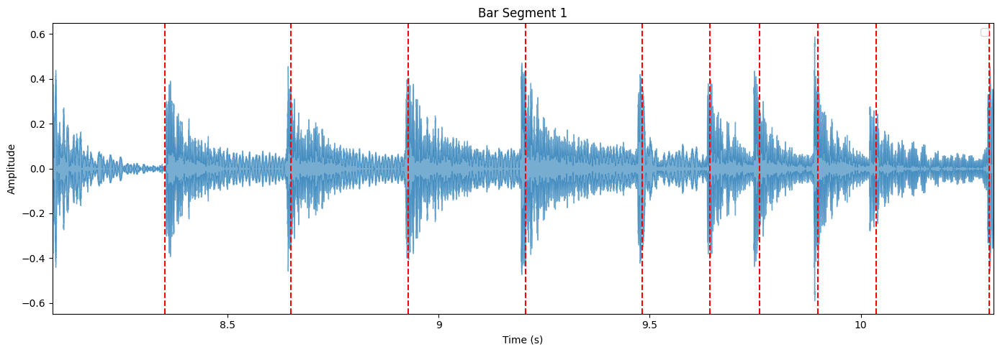

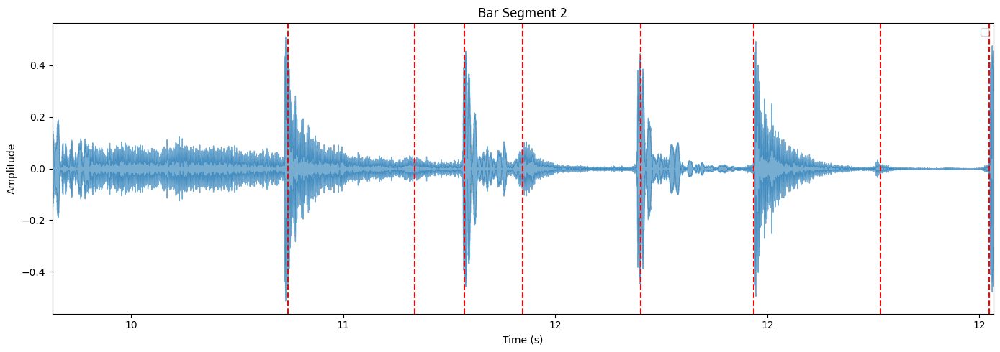

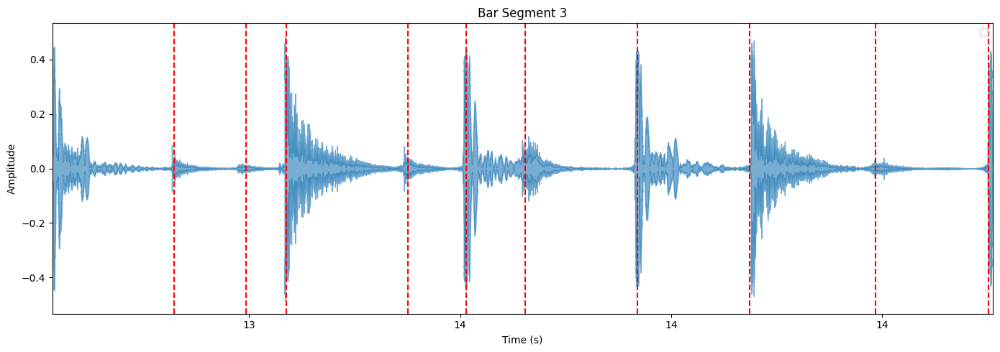

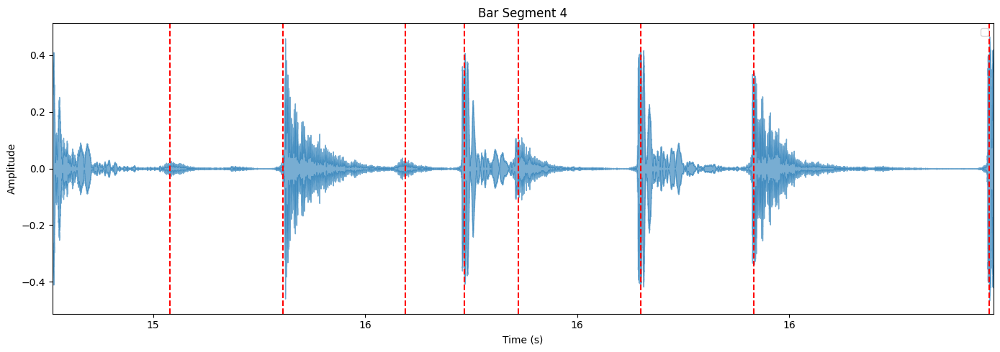

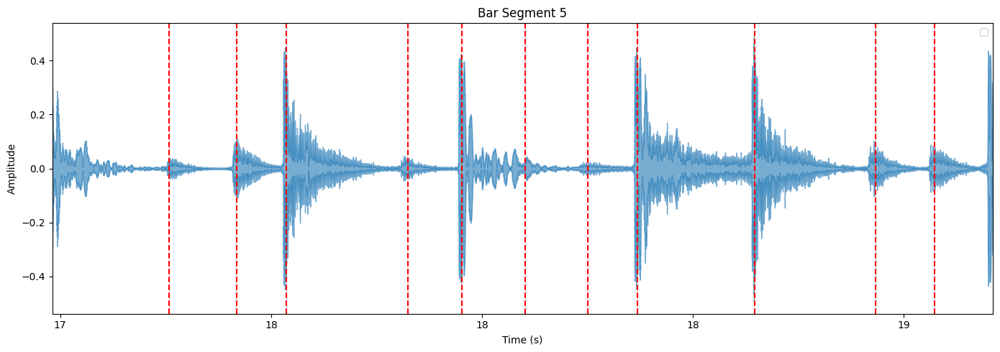

...

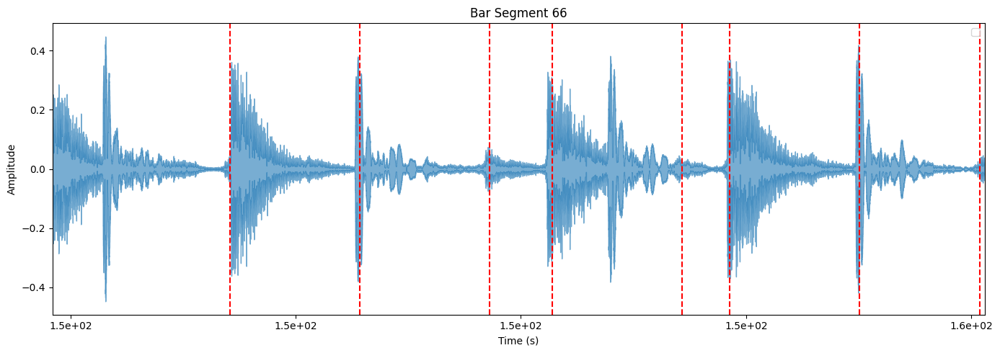

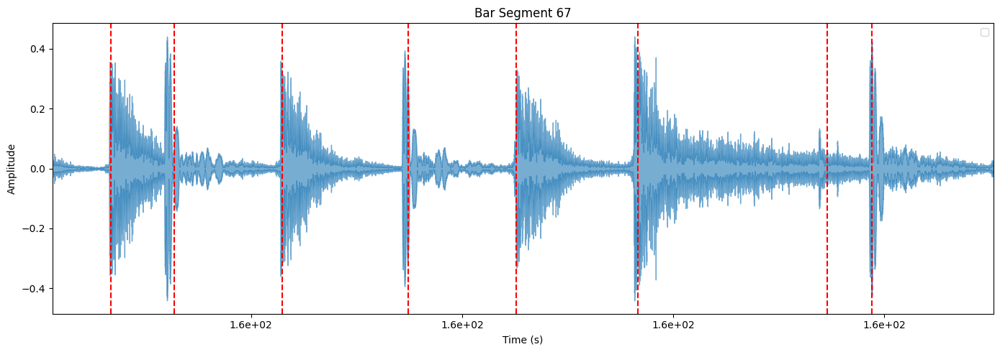

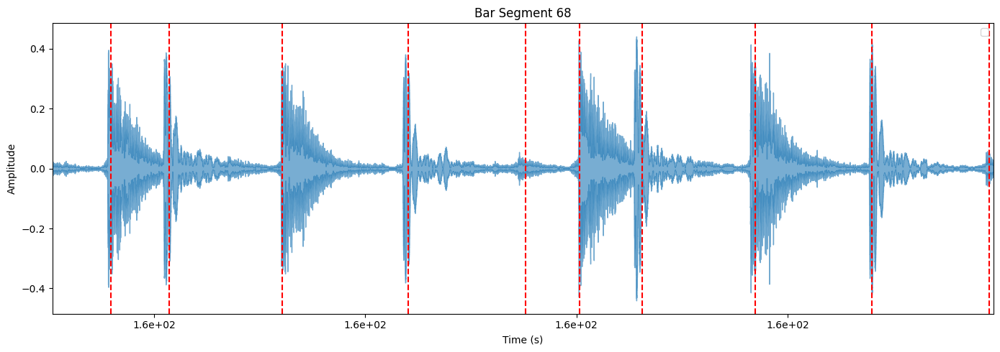

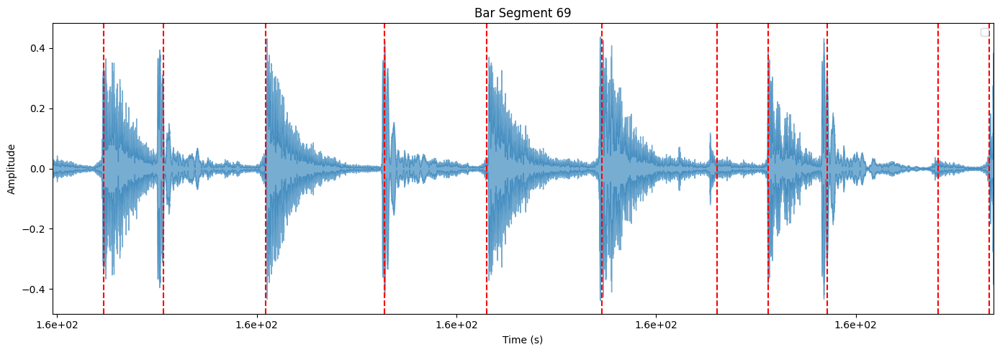

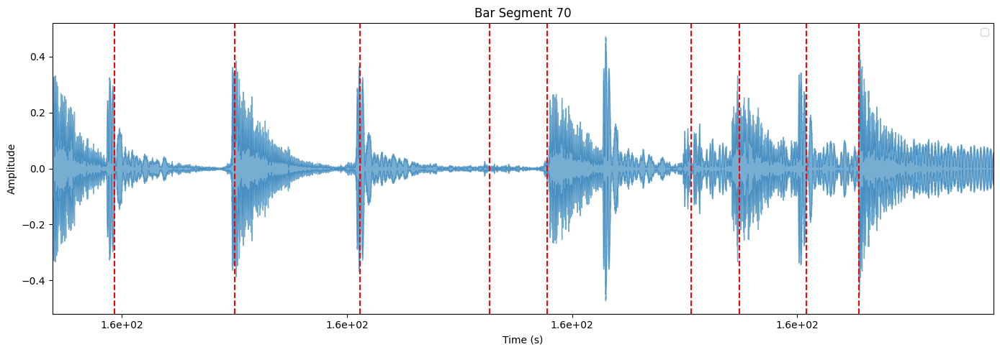

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# 오디오 파일 로드
audio_file = '/content/drive/MyDrive/soundAI/music/꿈나라별나라_demucs.wav'
y, sr = librosa.load(audio_file, sr=None)

# 템포 추정 및 비트 트래킹
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)

# 비트 프레임을 시간으로 변환
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

# 온셋 감지
onset_frames = librosa.onset.onset_detect(y=y, sr=sr)
onset_times = librosa.frames_to_time(onset_frames, sr=sr)

# 마디별 세그먼트 설정 및 시각화 (템포를 기준으로 마디 단위로 나누기)
# 일반적으로 4/4 박자라 가정하여 비트 4개마다 한 마디로 설정
beats_per_bar = 4  # 4/4 박자 기준

for i in range(0, len(beat_times) - beats_per_bar, beats_per_bar):
    start_time = beat_times[i]
    end_time = beat_times[i + beats_per_bar] if i + beats_per_bar < len(beat_times) else len(y) / sr

    # 현재 마디에 해당하는 오디오 데이터 추출
    start_sample = int(start_time * sr)
    end_sample = int(end_time * sr)
    y_segment = y[start_sample:end_sample]

    # 파형 시각화
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(y_segment, sr=sr, alpha=0.6, x_axis='time', offset=start_time)
    plt.xlim([start_time, end_time])
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(f'Bar Segment {i // beats_per_bar + 1}')

    # 온셋 시각화 (현재 마디 내의 온셋 표시)
    for onset in onset_times:
        if start_time <= onset < end_time:
            plt.axvline(x=onset, color='r', linestyle='--', linewidth=1.5, label='Onset' if onset == onset_times[0] else "")

    plt.legend()
    plt.tight_layout()
    plt.show()


해밍 윈도우 적용

<ipython-input-20-b29a35646df3>:42: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(y_segment, sr=sr, alpha=0.6, x_axis='time', offset=start_time)


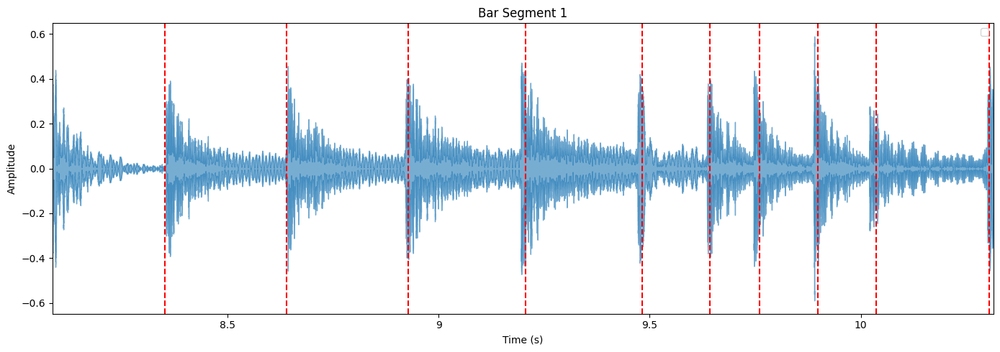

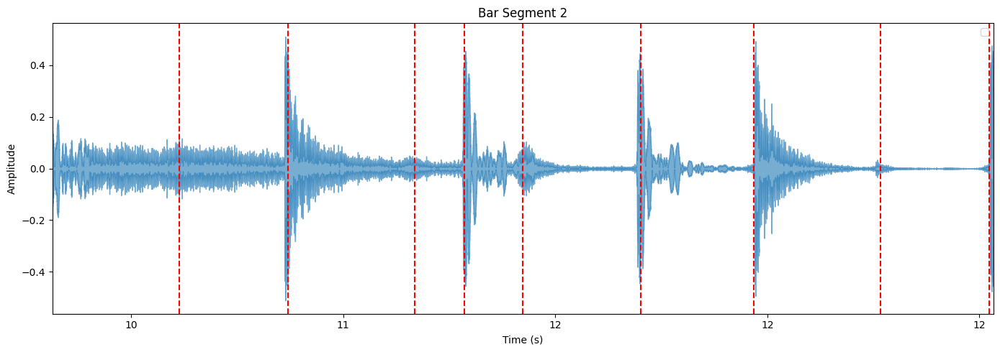

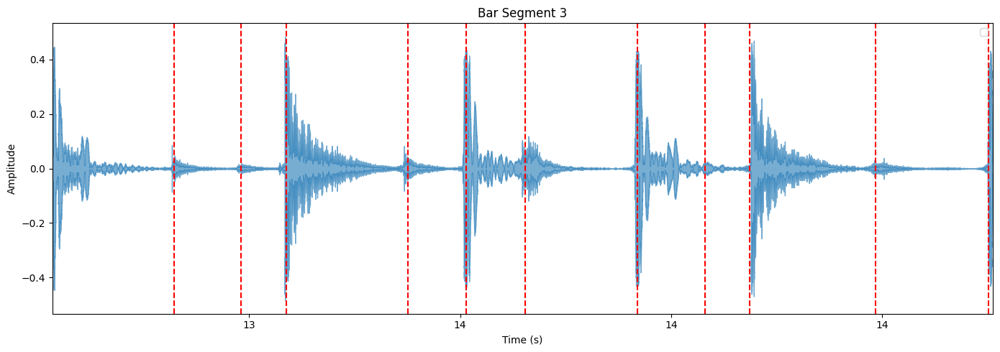

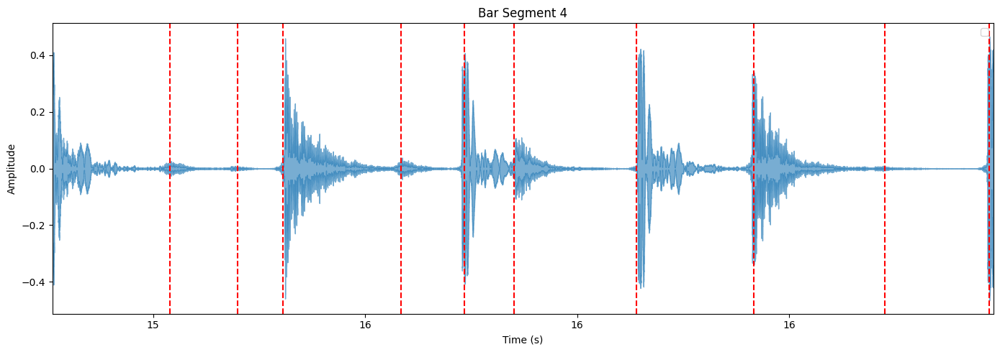

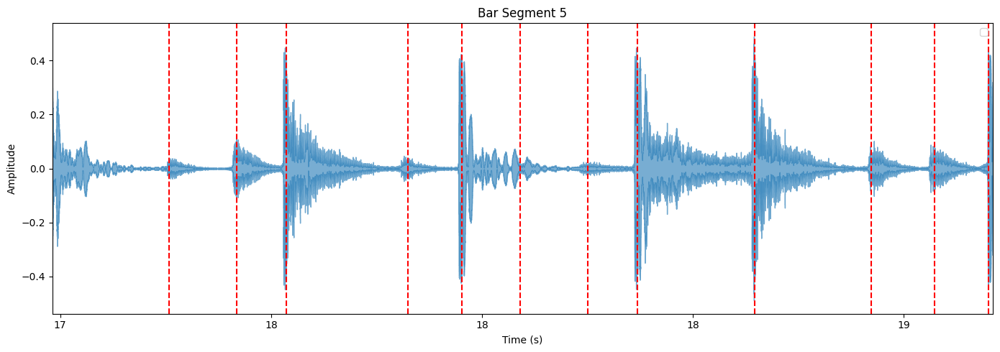

...

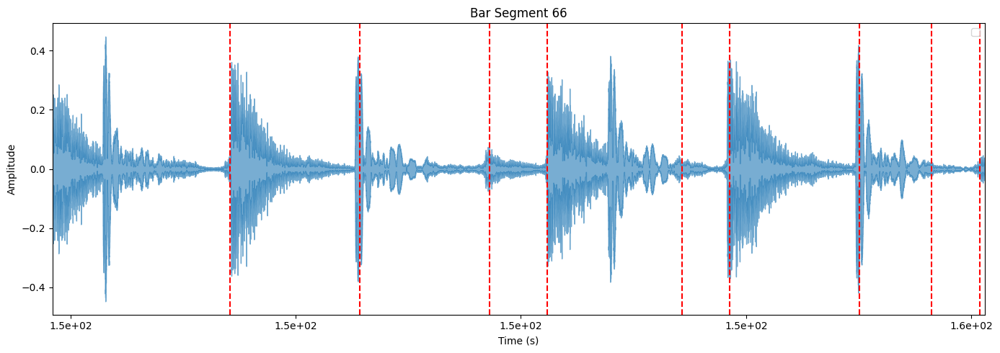

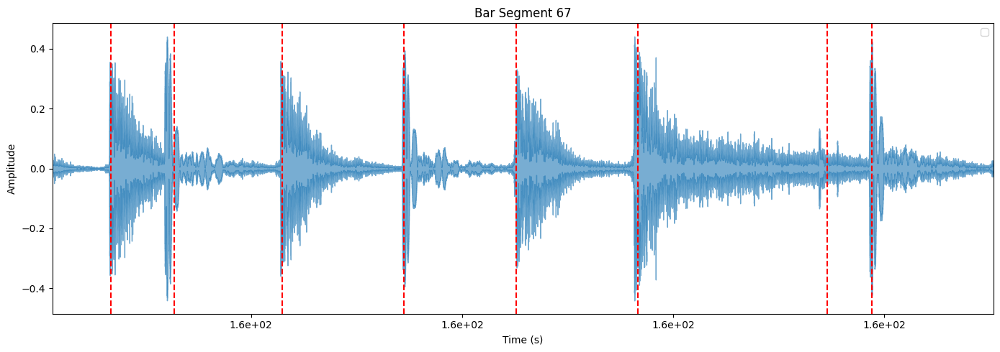

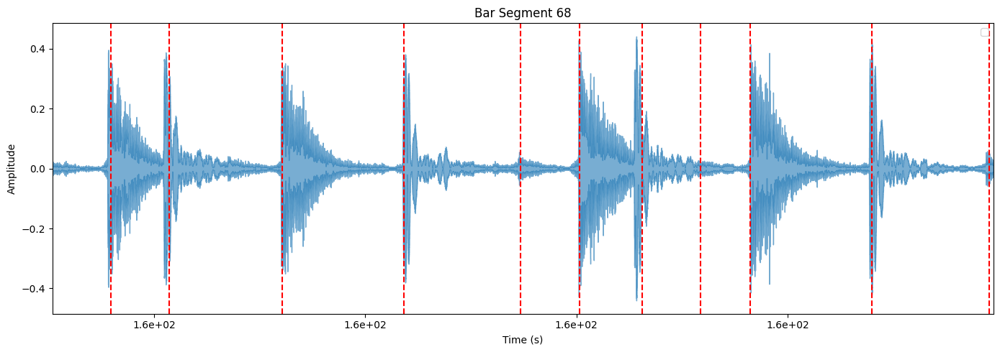

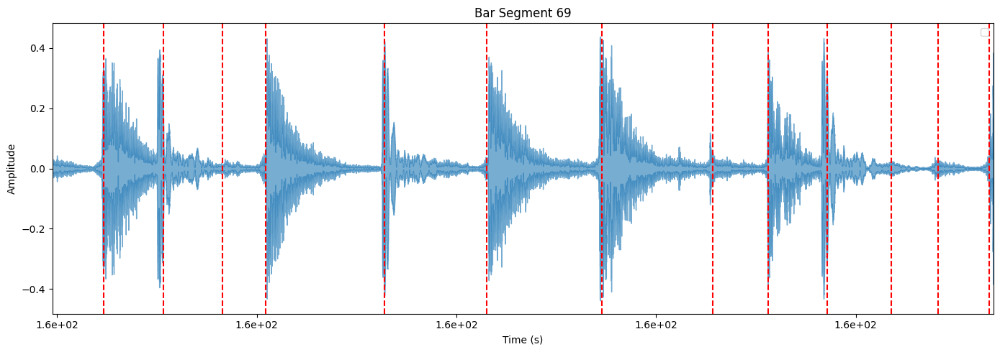

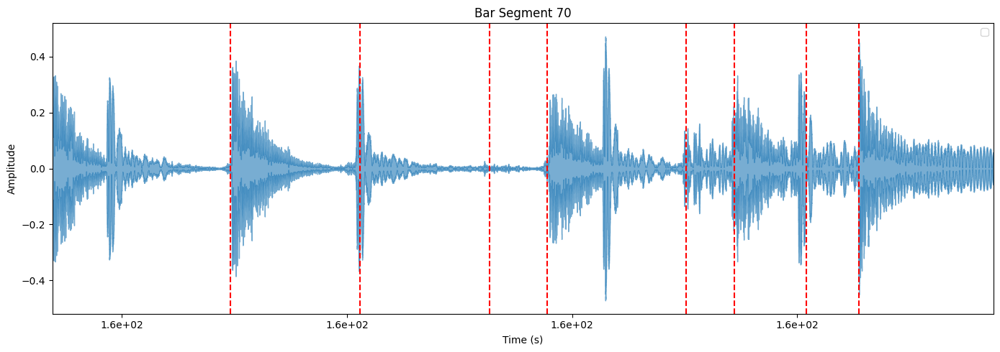

In [20]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# 오디오 파일 로드
audio_file = '/content/drive/MyDrive/soundAI/music/꿈나라별나라_demucs.wav'
y, sr = librosa.load(audio_file, sr=None)

# 해밍 윈도우 적용하여 온셋 감지
hop_length = 512  # 분석에 사용될 hop length 설정
win_length = 2048  # 윈도우 길이 설정

# 온셋을 감지할 때 해밍 윈도우 적용
# 1. 먼저, 온셋 envelope을 구하고
onset_envelope = librosa.onset.onset_strength(y=y, sr=sr, hop_length=hop_length, win_length=win_length, window='hamming')

# 2. 그 후, envelope을 기반으로 온셋 감지
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_envelope, sr=sr, hop_length=hop_length)
onset_times = librosa.frames_to_time(onset_frames, sr=sr)

# 템포 추정 및 비트 트래킹
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)

# 비트 프레임을 시간으로 변환
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

# 마디별 세그먼트 설정 및 시각화 (템포를 기준으로 마디 단위로 나누기)
beats_per_bar = 4  # 4/4 박자 기준

for i in range(0, len(beat_times) - beats_per_bar, beats_per_bar):
    start_time = beat_times[i]
    end_time = beat_times[i + beats_per_bar] if i + beats_per_bar < len(beat_times) else len(y) / sr

    # 현재 마디에 해당하는 오디오 데이터 추출
    start_sample = int(start_time * sr)
    end_sample = int(end_time * sr)
    y_segment = y[start_sample:end_sample]

    # 파형 시각화
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(y_segment, sr=sr, alpha=0.6, x_axis='time', offset=start_time)
    plt.xlim([start_time, end_time])
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(f'Bar Segment {i // beats_per_bar + 1}')

    # 온셋 시각화 (현재 마디 내의 온셋 표시)
    for onset in onset_times:
        if start_time <= onset < end_time:
            plt.axvline(x=onset, color='r', linestyle='--', linewidth=1.5, label='Onset' if onset == onset_times[0] else "")

    plt.legend()
    plt.tight_layout()
    plt.show()


YamNet 모델로 온셋 감지

In [ ]:
!pip install tensorflow
!pip install tensorflow-hub
!pip install librosa


In [ ]:
print (sr)

48000


<ipython-input-13-64cf5431adc8>:57: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(y_segment, sr=16000, alpha=0.6, x_axis='time', offset=start_time)


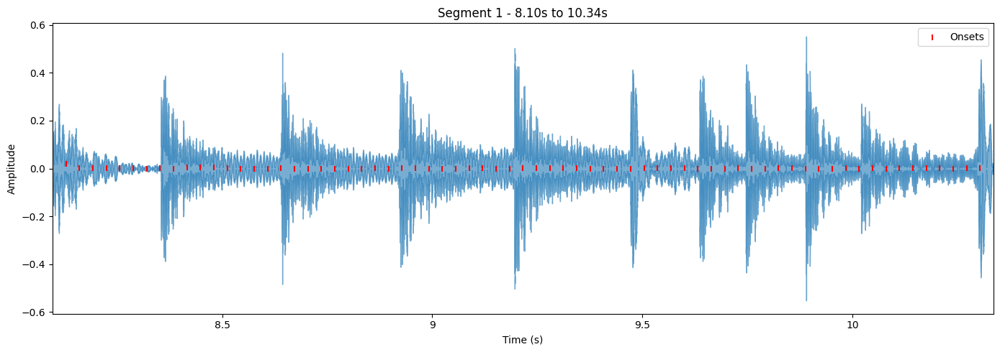

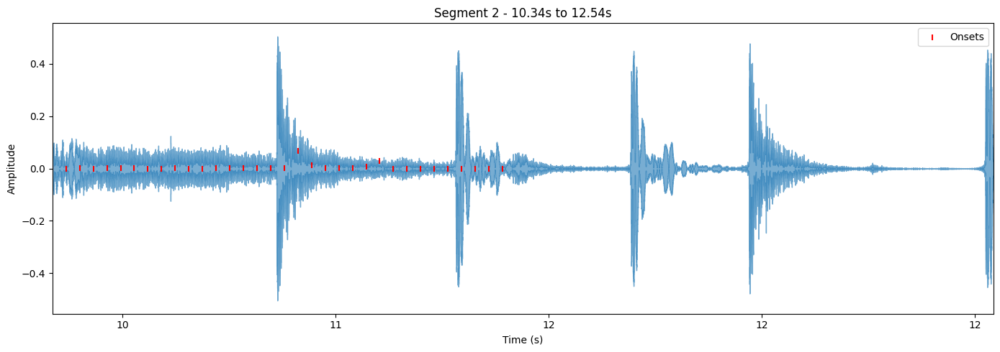

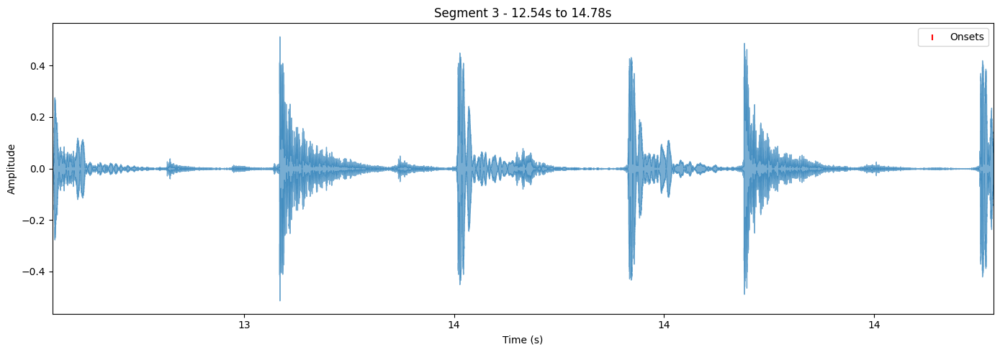

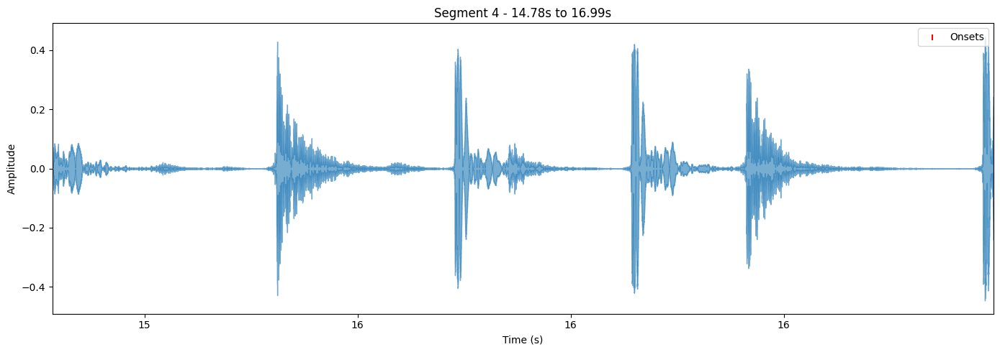

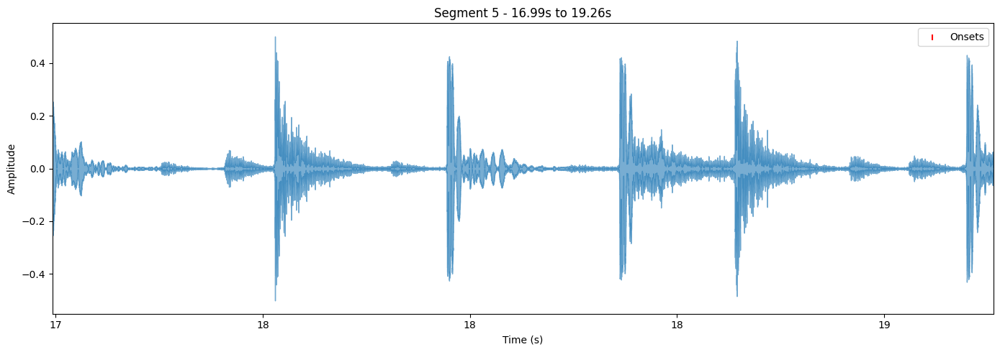

...

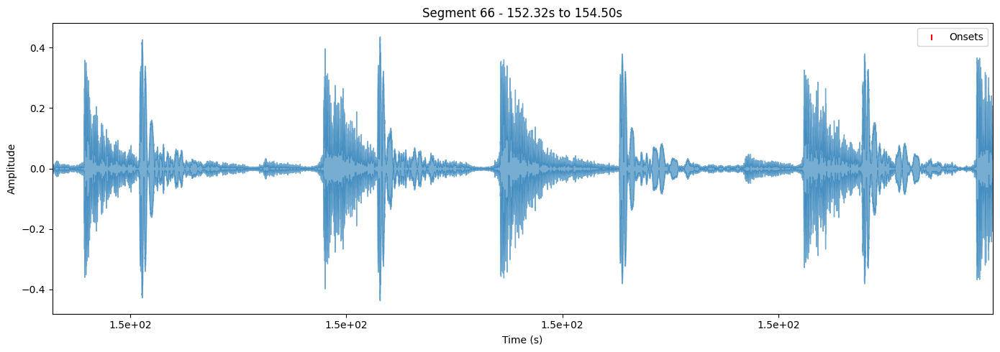

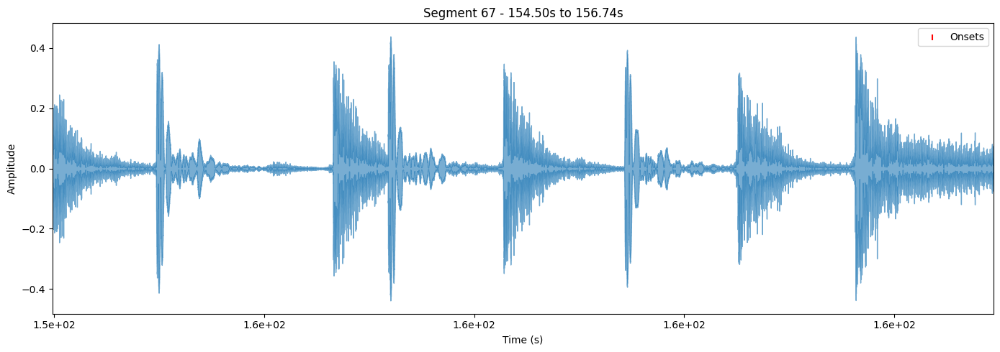

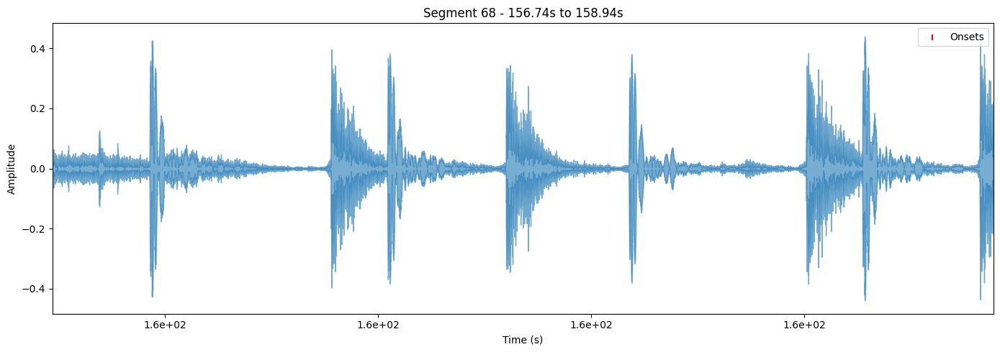

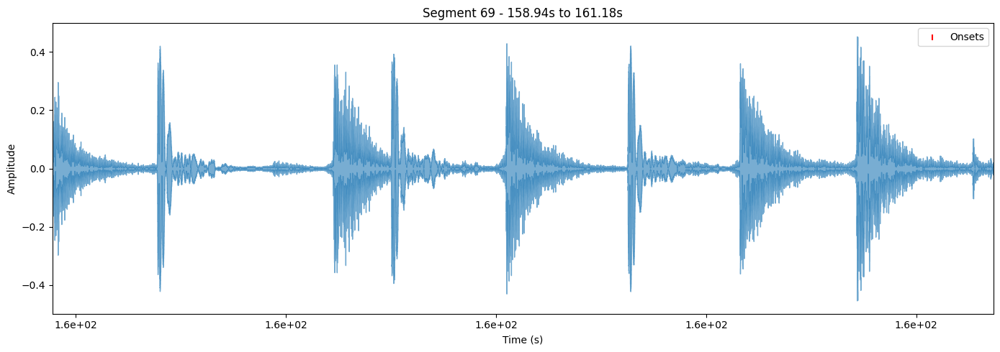

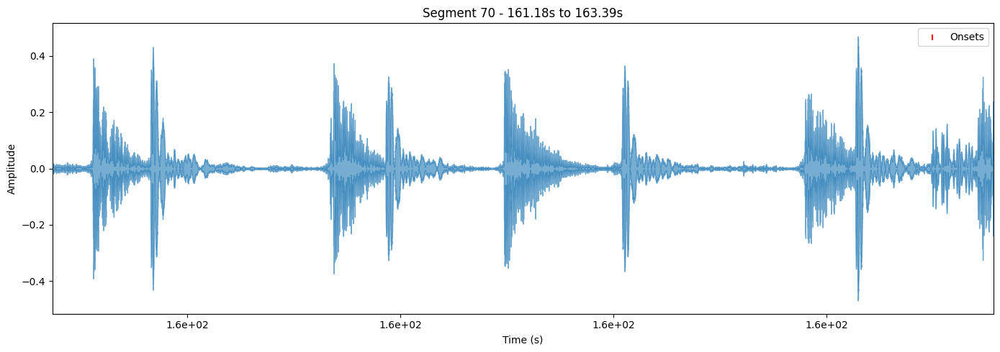

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# YAMNet 모델 로드
model = hub.load('https://tfhub.dev/google/yamnet/1')

# 오디오 파일 경로 (코랩 환경에 맞게 파일 경로 지정)
audio_file = '/content/drive/My Drive/soundAI/music/꿈나라별나라_demucs.wav'

# librosa를 이용하여 오디오 파일 로드
y, sr = librosa.load(audio_file, sr=None)

# YAMNet에 맞게 오디오 전처리 (샘플링 주파수를 16kHz로 맞추기)
y_resampled = librosa.resample(y, orig_sr=48000, target_sr=16000)

# YAMNet 모델에 입력할 수 있는 형태로 변환 (1D tensor)
waveform = tf.convert_to_tensor(y_resampled, dtype=tf.float32)

# YAMNet 예측 (scores는 2D 배열로 각 시간에서의 클래스별 확률을 반환)
scores, embeddings, spectrogram = model(waveform)

# 첫 번째 채널의 scores가 온셋에 해당 (음악 이벤트 감지)
onset_scores = scores[:, 0]

# 시간축에 대한 값을 얻기 위해 프레임을 시간으로 변환
frame_times = librosa.frames_to_time(np.arange(len(onset_scores)), sr=16000)

# 템포 추정 및 비트 트래킹
tempo, beat_frames = librosa.beat.beat_track(y=y_resampled, sr=16000)

# 비트 프레임을 시간으로 변환
beat_times = librosa.frames_to_time(beat_frames, sr=16000)

# 세그먼트 길이 설정 (4/4 박자 기준으로 마디를 나누는 방식)
beats_per_bar = 4  # 4/4 박자 기준

# 세그먼트 별로 오디오 파일과 온셋 시각화
for i in range(0, len(beat_times) - beats_per_bar, beats_per_bar):
    start_time = beat_times[i]
    end_time = beat_times[i + beats_per_bar] if i + beats_per_bar < len(beat_times) else len(y_resampled) / 16000

    # 현재 마디에 해당하는 오디오 데이터 추출
    start_sample = int(start_time * 16000)
    end_sample = int(end_time * 16000)
    y_segment = y_resampled[start_sample:end_sample]

    # 해당 세그먼트에 맞는 온셋 점 필터링
    segment_onset_times = frame_times[(frame_times >= start_time) & (frame_times < end_time)]
    segment_onset_scores = onset_scores[(frame_times >= start_time) & (frame_times < end_time)]

    # 파형 시각화
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(y_segment, sr=16000, alpha=0.6, x_axis='time', offset=start_time)
    plt.xlim([start_time, end_time])
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(f'Segment {i // beats_per_bar + 1} - {start_time:.2f}s to {end_time:.2f}s')

    # 온셋 시각화 (현재 마디 내의 온셋 표시)
    plt.scatter(segment_onset_times, segment_onset_scores, color='r', marker='|', label='Onsets')

    plt.legend(loc='upper right')
    plt.tight_layout()
    plt.show()


# Beat Extraction

'/content/drive/My Drive/soundAI/BoysLikeGirls.mp3'

MagicCarpetRide_drum.mp3

Every Day.mp3

music.mp3 //꿈나라별나라

Love From The Other Side.mp3

In [17]:
import librosa
import numpy as np
from sklearn.cluster import KMeans
from collections import Counter

# 오디오 파일 로드
audio_path = '/content/drive/My Drive/soundAI/BoysLikeGirls.mp3'  # 여기에 mp3 파일 경로를 입력하세요
y, sr = librosa.load(audio_path, sr=None)

# 온셋 디텍션
onset_frames = librosa.onset.onset_detect(y=y, sr=sr, backtrack=True)
onset_times = librosa.frames_to_time(onset_frames, sr=sr)

# 템포와 비트 추출
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

# 템포와 박자 정보 출력
print(f"Estimated Tempo: {tempo} BPM")  # 비트 후처리 필요

# 비트 간 간격 계산
beat_intervals = np.diff(beat_times)
mean_interval = np.mean(beat_intervals)
interval_variance = np.var(beat_intervals)  # 비트 간격의 분산
print(f"Mean Beat Interval: {mean_interval}")
print(f"Beat Interval Variance: {interval_variance}")

# BPM 조정 (두 배 템포를 고려)
adjusted_tempo = tempo
if adjusted_tempo < 80:  # 템포가 절반으로 추정된 경우 두 배로 조정
    adjusted_tempo *= 2
print("Adjusted Tempo:", adjusted_tempo)

# 클러스터링 기반 4/4 인식
pattern_detected = False

# 클러스터링: 4개의 주요 비트 간격 그룹 확인
kmeans = KMeans(n_clusters=4, random_state=0).fit(beat_intervals.reshape(-1, 1))
cluster_counts = Counter(kmeans.labels_)

# 4개의 주요 클러스터가 일정하게 반복될 경우 4/4로 고정
if max(cluster_counts.values()) >= len(beat_intervals) * 0.8:
    print("Detected Time Signature: 4/4")
else:
    # 다양한 박자 패턴 확인
    for beat_pattern in [4, 3, 5, 6, 7]:  # 감지하고자 하는 박자 패턴 목록
        try:
            pattern_check = np.allclose(
                beat_intervals[:len(beat_intervals) // beat_pattern * beat_pattern].reshape(-1, beat_pattern).mean(axis=1),
                mean_interval,
                atol=0.05
            )
            if pattern_check:
                print(f"Detected Time Signature: {beat_pattern}/4 or {beat_pattern}/8")
                pattern_detected = True
                break
        except ValueError:
            # 간격 배열이 beat_pattern으로 나누어지지 않을 경우 발생할 수 있는 오류 방지
            continue

    if not pattern_detected:
        print("Detected Time Signature is irregular or complex.")


Estimated Tempo: [74.89809783] BPM
Mean Beat Interval: 0.7982591131690773
Beat Interval Variance: 0.0012164461200696512
Adjusted Tempo: [149.79619565]
Detected Time Signature: 4/4
